# Camera Calibration

- ✅ Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
- ✅ Apply a distortion correction to raw images.


In [12]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
%matplotlib inline
import os
import glob
import math
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

# create directories 
if not os.path.exists("output01_undistorted_imgs/"):
    os.makedirs("output01_undistorted_imgs/")
if not os.path.exists("output02_binary_imgs/"):
    os.makedirs("output02_binary_imgs/")
if not os.path.exists("output03_warped_imgs/"):
    os.makedirs("output03_warped_imgs/")    
if not os.path.exists("output04_fitted_imgs/"):
    os.makedirs("output04_fitted_imgs/")        
if not os.path.exists("test_videos_output/"):
    os.makedirs("test_videos_output/")    
    
# utility functions    
def show_preview(images, columns=2, disp_sizex=0, disp_sizey=0):
    if len(images) == 0:
        print('Nothing to preview')
        return
    rows = int(len(images)/columns) + (0 if len(images)%columns == 0 else 1)
    
    if disp_sizex == 0:
        disp_sizex = int(columns * 30)
    if disp_sizey == 0:
        disp_sizey = rows * 15
    fig = plt.figure(figsize=(disp_sizex, disp_sizey))
    for idx, img in enumerate(images):
        fig.add_subplot(rows, columns, idx+1)
        plt.imshow(img)
    plt.show()

def plot_preview(images, row=2, sizex=60, sizey=30):
    fig = plt.figure(figsize=(sizex, sizey))
    for idx, img in enumerate(images):
        fig.add_subplot(len(images)/row, row, idx+1)
        plt.plot(img)
    plt.show()

# Preparation 

- **calibrate the camera**, using the chessboard images
- get the **perspective transformation matrix**, using the straight line images

## Functions for camera calibration

In [2]:
def get_objpoints_imgpoints_from_chessboard_pics():
    # Disclaimer: Using code from the example python notebook and adjust it
    cal_images = glob.glob("camera_cal/*.jpg")

    # Find Chessboard corners for calibration
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    # Store all images to preview them for visual "debugging"
    images = []


    # Step through the list and search for chessboard corners
    for idx, fname in enumerate(cal_images):
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

        # If found, add object points, image points and draw & display corners
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
            img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        else:
            print('Cannot find chessboard corners in ' + fname)
        images.append(img)
        
    # # for visual "debugging"    
    # show_preview(images, 6, 15, 15)
    
    return objpoints, imgpoints

def undistort(fname, mtx, dist):
    img = cv2.undistort(mpimg.imread(fname), mtx, dist, None, mtx)
    return fname, img

def save_undistorted(undistorted_pack):
    fname, img = undistorted_pack
    cv2.imwrite('output01_undistorted_imgs/' + fname[12:], cv2.cvtColor(img, cv2.COLOR_RGB2BGR))
    return img



In [3]:

# # Show preview of all calibration images
# fig = plt.figure(figsize=(15, 15))
# images = list(map(lambda x: mpimg.imread(x), cal_images))
# show_preview(images, 6)


## Functions for the perspective transformation matrix

about to move -25
0
-25
moving -25
0
-25
1091
about to move -27
-1
-27
moving -27
-1
-27
849
about to move 22
-2
22
moving 22
-2
22
675
0
0
0
0
0
0
0
0
0


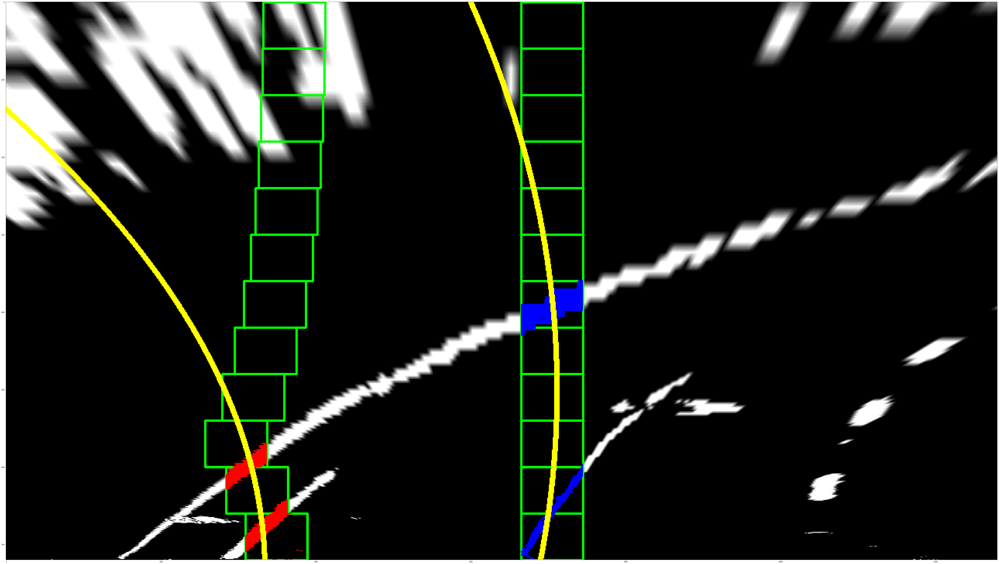

In [30]:
#  EXPERIMENTAL PLAYGROUND



# General Parameters
img_size = (1280, 720)
# Parameters to undistort from calibrated camera
mtx = mtx
dist = dist
# Parameters for perspective transformations
M = M
Minv = Minv


# PARAMS TAKEN FROM CLASS
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# -----------------------------------------------#
# Functions to find lane pixels in warped image:
# -----------------------------------------------#

def find_lane_pixels(binary_warped):
    
# 314 and 1223
# 177 and 1170
# 258 and 1191
# 258 and 1222
# 315 and 1165
# 277 and 1157
# 212 and 1122
# 210 and 1108
# 349 and 1058
# 271 and 1257
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]*(1/2)):,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
#     print(histogram.shape)
#     print(histogram)
#     for x in range(200,260):
#         histogram[x] = 2* histogram[x]
#     for x in range(1100,1160):
#         histogram[x] = 2* histogram[x]
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 12
    # Set the width of the windows +/- margin
    margin = 40
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Set minimum number of pixels found to lose confidence
    min_low_confidence_pix = 100
    min_confidence_pix = 200
    # Set number of rounds without confidence to stop
    rounds_lose_confidence = 3
    
    # Set number direction hints to have confidence
    rounds_direction_confidence = 2

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    left_didnt_find_many_pix = 0
    right_didnt_find_many_pix = 0
    
    left_stop = False
    right_stop = False

    leftx_diff = 0
    rightx_diff = 0
    old_leftx_diff = 0
    old_rightx_diff = 0

    left_dir = 0
    right_dir = 0
    
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        if not left_stop:
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        if not right_stop:
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        if not left_stop:
            left_lane_inds.append(good_left_inds)
        if not right_stop:
            right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        
        if len(good_left_inds) > minpix:
            new_leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            leftx_diff = new_leftx_current - leftx_current
            leftx_diff = int(1.5*leftx_diff + 0.5*old_leftx_diff)
            print('about to move ' + str(leftx_diff))
            print(left_dir)
            print(leftx_diff)
            if left_dir == 0 or not (abs(left_dir) > rounds_direction_confidence and np.sign(leftx_diff) != np.sign(left_dir)):
                if abs(leftx_diff) < 100:
                    print('moving ' + str(leftx_diff))
                    leftx_current = leftx_current + leftx_diff
            print(left_dir)
            print(leftx_diff)


            left_dir = left_dir + (1 if leftx_diff > 0 else (-1 if leftx_diff < 0 else 0))
        else:
            leftx_diff = int(0.75*old_leftx_diff)
            leftx_current = leftx_current + leftx_diff
        if len(good_right_inds) > minpix:
            new_rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            rightx_diff = int(2*rightx_diff + 0.5*old_rightx_diff)
            if right_dir == 0 or not (abs(right_dir) > rounds_direction_confidence and np.sign(rightx_diff) != np.sign(right_dir)):
                if abs(rightx_diff) < 100:
                    rightx_current = rightx_current + rightx_diff
            right_dir = right_dir + (1 if rightx_diff > 0 else (-1 if rightx_diff < 0 else 0))
        else:
            rightx_diff = int(0.75*old_rightx_diff)
            rightx_current = rightx_current + rightx_diff

        print(len(good_left_inds))
        if len(good_left_inds) < min_low_confidence_pix:
            left_didnt_find_many_pix = left_didnt_find_many_pix + 1
        elif len(good_left_inds) > min_confidence_pix:
            left_didnt_find_many_pix = 0
        if len(good_right_inds) < min_low_confidence_pix:
            right_didnt_find_many_pix = right_didnt_find_many_pix + 1
        elif len(good_right_inds) > min_confidence_pix:
            right_didnt_find_many_pix = 0
            
        if left_didnt_find_many_pix > rounds_lose_confidence:
            left_stop = True
        if right_didnt_find_many_pix > rounds_lose_confidence:
            right_stop = True
            
        old_leftx_diff = leftx_diff
        old_rightx_diff = rightx_diff

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img





def run_pipeline(img, fname=""):
    save_img = fname != ""

    img_undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    if save_img:
        cv2.imwrite('output01_undistorted_imgs/' + fname, cv2.cvtColor(img_undistorted, cv2.COLOR_RGB2BGR))
    
    img_binary = make_binary(img_undistorted)
    img_cropped = crop_to_roi(img_binary)

    if save_img:
        cv2.imwrite('output02_binary_imgs/' + fname, cv2.cvtColor(img_cropped, cv2.COLOR_RGB2BGR))
        
#     plt.figure(figsize=(100,100))
#     plt.imshow(img_cropped)
    
    img_warped = cv2.warpPerspective(img_cropped, M, img_size)
    img_warped_gray = cv2.cvtColor(img_warped, cv2.COLOR_RGB2GRAY)
    if save_img:
        cv2.imwrite('output03_warped_imgs/' + fname, cv2.cvtColor(img_warped, cv2.COLOR_RGB2BGR))


        
    img_fitted_pack = fit_polynomial(img_warped_gray)
    img_fitted, ploty, left_fit, left_fit_cr, right_fit, right_fit_cr, left_fitx, right_fitx = img_fitted_pack
    # paint fitted curve onto image         
    for point in zip(left_fitx.astype(int), ploty.astype(int)):
        cv2.circle(img_fitted,point,2,(255,255,0),2)
    for point in zip(right_fitx.astype(int), ploty.astype(int)):
        cv2.circle(img_fitted,point,2,(255,255,0),2)
    if save_img:
        cv2.imwrite('output04_fitted_imgs/' + fname, cv2.cvtColor(img_fitted, cv2.COLOR_RGB2BGR))
    
#     plt.figure(figsize=(100,100))
#     plt.imshow(img_fitted)
    return img_fitted
        
    txt = get_description_text(ploty, left_fit_cr, right_fit_cr, left_fitx, right_fitx)
    img_annotated = warp_back(img_warped_gray, img_undistorted, img_undistorted, txt, Minv, ploty, left_fitx, right_fitx)
    if save_img:
        cv2.imwrite('output_images/' + fname, cv2.cvtColor(img_annotated, cv2.COLOR_RGB2BGR))
    
    return img_annotated

# img = mpimg.imread('own_tests/1.jpg')
# test = run_pipeline(img)
# plt.figure(figsize=(100,100))
# plt.imshow(test)



img = mpimg.imread('test_images/custom2.jpg')
res = run_pipeline(img)
plt.figure(figsize=(100,100))
plt.imshow(res)


# results = []
# for fname in glob.glob('test_images/custom*.jpg'):
#     img = mpimg.imread('test_images/custom1.jpg')
#     res = run_pipeline(img, fname[12:])
#     results.append(res)
# show_preview(results)





# def make_binary(img):
#     img = img.copy()

#     s_thresh=(170, 255)
#     sx_thresh=(20, 100)
    
#     hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

# #     # detect yellow and white colors (only on the lower half) and hopefully find lanes    
# #     yellow_mask = cv2.inRange(hls, np.array([15,40,50]), np.array([25,255,255]))
# #     yellow_mask[:int(yellow_mask.shape[0]*(4/7)),:] = np.zeros_like(yellow_mask[:int(yellow_mask.shape[0]*(4/7)),:])
# #     white_mask = cv2.inRange(hls, np.array([0,200,0]), np.array([255,255,255]))
# #     white_mask[:int(white_mask.shape[0]*(4/7)),:] = np.zeros_like(white_mask[:int(white_mask.shape[0]*(4/7)),:])
    
# #     # if the masks are too aggressive it is unlikely that we only found lanes, so we remove them
# #     if len(yellow_mask.nonzero()[0]) > (5/100) * yellow_mask.shape[0] * yellow_mask.shape[1]:
# #         yellow_mask = np.zeros_like(yellow_mask)

# #     if len(white_mask.nonzero()[0]) > (5/100) * white_mask.shape[0] * white_mask.shape[1]:
# #         white_mask = np.zeros_like(white_mask)

#     l_channel = hls[:,:,1]
#     s_channel = hls[:,:,2]
#     # Sobel x
#     sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
#     abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
#     scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
#     # Threshold x gradient
#     sxbinary = np.zeros_like(scaled_sobel)
#     sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
#     # Threshold color channel
#     s_binary = np.zeros_like(s_channel)
#     s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
#     # Stack each channel
#     color_binary = np.dstack(( yellow_mask, sxbinary, s_binary)) * 255
#     real_binary = np.zeros_like(s_binary)
#     real_binary[(sxbinary > 0) | (s_binary > 0)] = 255
# #     real_binary[(sxbinary > 0) | (s_binary > 0) | (yellow_mask > 0) | (white_mask > 0)] = 255
#     real_binary = cv2.cvtColor(real_binary, cv2.COLOR_GRAY2RGB)
#     return real_binary



# # img = mpimg.imread('own_tests/1.jpg')
# img = mpimg.imread('test_images/test4.jpg')
# hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

# # detect yellow and white colors (only on the lower half) and hopefully find lanes    
# yellow_mask = cv2.inRange(hls, np.array([15,40,70]), np.array([25,255,255]))
# yellow_mask[:int(yellow_mask.shape[0]*(4/7)),:] = np.zeros_like(yellow_mask[:int(yellow_mask.shape[0]*(4/7)),:])
# yellow_mask = cv2.cvtColor(yellow_mask, cv2.COLOR_GRAY2RGB)

# plt.figure(figsize=(100,100))
# plt.imshow(np.vstack((img,yellow_mask)))



# # # white_mask = cv2.inRange(hls, np.array([0,200,0]), np.array([255,255,255]))
# # # whilte = cv2.cvtColor(white_mask, cv2.COLOR_GRAY2RGB)
# # # s_channel = cv2.cvtColor(hls[:,:,1], cv2.COLOR_GRAY2RGB)
# # # v_channel = cv2.cvtColor(hls[:,:,2], cv2.COLOR_GRAY2RGB)
# # # img_bin = make_binary(img)
# # plt.figure(figsize=(100,100))
# # plt.imshow(np.vstack((img,whilte)))
# # # test = run_pipeline(img)

In [28]:
# disclaimer: copied code from the lesson and adjusted


def make_binary(img):
    img = img.copy()

    s_thresh=(170, 255)
    sx_thresh=(20, 100)
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

    # detect yellow and white colors (only on the lower half) and hopefully find lanes    
    yellow_mask = cv2.inRange(hls, np.array([15,40,70]), np.array([25,255,255]))
    yellow_mask[:int(yellow_mask.shape[0]*(4/7)),:] = np.zeros_like(yellow_mask[:int(yellow_mask.shape[0]*(4/7)),:])
    white_mask = cv2.inRange(hls, np.array([0,200,0]), np.array([255,255,255]))
    white_mask[:int(white_mask.shape[0]*(4/7)),:] = np.zeros_like(white_mask[:int(white_mask.shape[0]*(4/7)),:])
    
    # if the masks are too aggressive it is unlikely that we only found lanes, so we remove them
    if len(yellow_mask.nonzero()[0]) > (5/100) * yellow_mask.shape[0] * yellow_mask.shape[1]:
        yellow_mask = np.zeros_like(yellow_mask)

    if len(white_mask.nonzero()[0]) > (5/100) * white_mask.shape[0] * white_mask.shape[1]:
        white_mask = np.zeros_like(white_mask)

    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    color_binary = np.dstack(( yellow_mask, sxbinary, s_binary)) * 255
    real_binary = np.zeros_like(s_binary)
    real_binary[(sxbinary > 0) | (s_binary > 0) | (yellow_mask > 0) | (white_mask > 0)] = 255
    real_binary = cv2.cvtColor(real_binary, cv2.COLOR_GRAY2RGB)
    return real_binary

# disclaimer: copied the code to find straight lines from my submission for P1
def get_img_height_width(img):
    img_shape = img.shape
    return img_shape[0], img_shape[1]

def crop_to_roi(img):
    img_height, img_width = get_img_height_width(img)
    vertices = np.array([[(50,img_height),
                          ((5/11)*img_width,(4/7)*img_height),
                          ((6/11)*img_width,(4/7)*img_height),
                          (img_width-50,img_height)]],
                          dtype=np.int32)
    return region_of_interest(img, vertices)

def region_of_interest(img, vertices):
    mask = np.zeros_like(img)   
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image    
    
# this is old code from my submission for P1, slightly adjusted to find straight lanes

def get_slope(line):
    for x1,y1,x2,y2 in line:
        return (y2-y1)/(x2-x1)
def get_img_height_width(img):
    img_shape = img.shape
    return img_shape[0], img_shape[1]

def get_intersection(slope1, intercept1, slope2, intercept2):
    intersection_x = (intercept2 - intercept1)/(slope1 - slope2)
    intersection_y = intersection_x * slope1 + intercept1
    return intersection_x, intersection_y

def get_intercept(line):
    slope = get_slope(line)
    for x1,y1,x2,y2 in line:
        return y1 - slope * x1
def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)
def get_avg(data):
    if len(data) == 0:
        return -1
    return sum(data) / len(data)
def extrapolate_lanes(img, lines):
    img_height, img_width = get_img_height_width(img)

    slopes = list(map(lambda line: get_slope(line), lines))
    intercepts = list(map(lambda line: get_intercept(line), lines))

    # group data by slope
    slopes_cp = slopes.copy()
    slopes_cp, intercepts = (list(t) for t in zip(*sorted(zip(slopes_cp, intercepts), key=lambda tup: tup[0])))
    slopes, lines = (list(t) for t in zip(*sorted(zip(slopes, lines), key=lambda tup: tup[0])))

    num_gaps = 0    

    for s in range(len(slopes) - 1):
        if slopes[s+1] - slopes[s] > 0.5 or abs(intercepts[s+1] - intercepts[s]) > 100:
            num_gaps = num_gaps + 1
    
    freq, bins = np.histogram(slopes, num_gaps+1)

    # group detected lines by slopes and intercepts
    bins_slopes = []
    bins_lines = []
    bins_intercepts = []
    bin_start = 0
    for bin_count in range(len(freq)):
        if freq[bin_count] == 0:
            continue
        bins_slopes.append(slopes[bin_start:bin_start+freq[bin_count]])
        bins_lines.append(lines[bin_start:bin_start+freq[bin_count]])
        bins_intercepts.append(intercepts[bin_start:bin_start+freq[bin_count]])
        bin_start = bin_start + freq[bin_count]
    
    avg_slopes = list(map(lambda x: get_avg(x), bins_slopes))
    avg_intercepts = list(map(lambda x: get_avg(x), bins_intercepts))

    # tend to cases where more or less than two lanes were identified
    if len(avg_slopes) > 2:
        left_id = -1
        left_intercept = -100000
        right_id = -1
        right_intercept = 100000
        for i in range(len(avg_slopes)):
            if avg_slopes[i] < 0 and avg_intercepts[i] > left_intercept:
                left_id = i
                left_intercept = avg_intercepts[i]
            if avg_slopes[i] > 0 and avg_intercepts[i] < right_intercept:
                right_id = i
                right_intercept = avg_intercepts[i]
        if left_id != -1 and right_id != -1:
            avg_slopes = list((avg_slopes[left_id],avg_slopes[right_id]))
            avg_intercepts = list((avg_intercepts[left_id],avg_intercepts[right_id]))
        elif left_id != -1:
            avg_slopes = avg_slopes[left_id:left_id+1]
            avg_intercepts = avg_intercepts[left_id:left_id+1]
        elif right_id != -1:
            avg_slopes = avg_slopes[right_id:right_id+1]
            avg_intercepts = avg_intercepts[right_id:right_id+1]

    if len(avg_slopes) < 2:
        intersection_x, intersection_y = int(img_width/2), int(img_height/2)
    else:
        intersection_x, intersection_y = get_intersection(avg_slopes[0], avg_intercepts[0], avg_slopes[1], avg_intercepts[1])

    # draw lane lines
    extra_lines = []
    for lane in range(0,len(avg_slopes)):
        x1 = (intersection_y + 35 - avg_intercepts[lane]) / avg_slopes[lane]
        x2 = (img_height - avg_intercepts[lane]) / avg_slopes[lane]
        
        if x1 == float("inf") or x2 == float("inf"):
            continue
        if avg_slopes[lane] == -1 or avg_intercepts[lane] == -1:
            continue

        extra_lines.append([int(x1),
                            int(intersection_y + 35),
                            int(x2),
                            img_height])
        line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(line_img, np.array([extra_lines]), [255, 0, 0], 5)

    return line_img, extra_lines
def weighted_img(img, initial_img, α=0.8, β=1., γ=0.):
    return cv2.addWeighted(initial_img, α, img, β, γ)

# This func finds straight lanes in an image and uses the fact that the lanes are straight
# to warp the image that way that the detected lanes are shown as a rectangle
# By doing this we find a perspective transformation that converts an on-top-of-car-view to an eagle-view of the road
def GetPerspectiveTransform(straight_lane_images):
    perspective_transforms = []
    perspective_transforms_inv = []

    for img in straight_lane_images:
        # run pipeline as in P1 on how to detect straight lanes:
        img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        img_gaussian = cv2.GaussianBlur(img, (7, 7), 0)
        img_canny = cv2.Canny(img_gaussian, 200, 240)
        img_cropped = crop_to_roi(img_canny)
        lines = cv2.HoughLinesP(img_cropped, 2, np.pi/180, 50, np.array([]), 10, 20)
        
        # get the pixel positions of the lane by detecting and extrapolating the lanes
        extrapolated_lines, line_pxs = extrapolate_lanes(img_cropped, lines)
        img_weighted = weighted_img(extrapolated_lines, img)

        # get points from the lanes and know as source points
        src = np.float32([[[line_pxs[0][0],line_pxs[0][1]]],
                          [[line_pxs[0][2],line_pxs[0][3]]],
                          [[line_pxs[1][0],line_pxs[1][1]]],
                          [[line_pxs[1][2],line_pxs[1][3]]]])
        # knowing that the lanes are straight, set destination points in a rectangle
        dst = np.float32([[[410,0]],
                          [[410,720]],
                          [[910,0]],
                          [[910, 720]]])

        # get the transformation matrices        
        M = cv2.getPerspectiveTransform(src, dst)
        Minv = cv2.getPerspectiveTransform(dst, src)

        perspective_transforms.append(M)
        perspective_transforms_inv.append(Minv)

    M = np.mean(perspective_transforms, axis=0)
    Minv = np.mean(perspective_transforms_inv, axis=0)
    return M, Minv


## Run the preparations

- get the camera calibrations from the chessboard images
- undistort all test images
- get the perspective transformation matrices from the images with straight lanes

Cannot find chessboard corners in camera_cal/calibration5.jpg
Cannot find chessboard corners in camera_cal/calibration4.jpg
Cannot find chessboard corners in camera_cal/calibration1.jpg


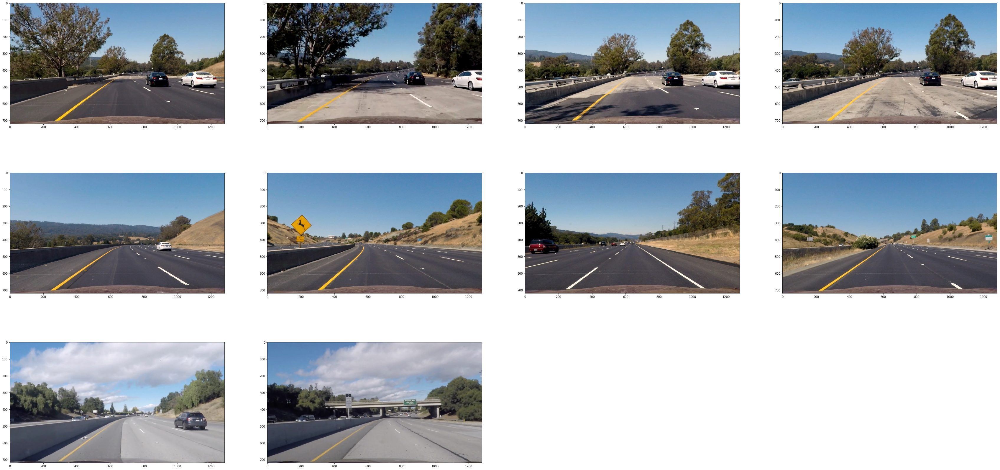

In [13]:

objpoints, imgpoints = get_objpoints_imgpoints_from_chessboard_pics()

# get parameters for camera calibrations
img_sample = cv2.cvtColor(mpimg.imread('camera_cal/calibration5.jpg'), cv2.COLOR_RGB2GRAY)
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_sample.shape[::-1], None, None)

# Undistort all test images
images = list(map(lambda x: save_undistorted(undistort(x, mtx, dist)), glob.glob("test_images/*jpg")))
show_preview(images, 4, 60, 30)

# Get perspective transformations from straight line images
undistorted_straight_imgs = list(map(lambda x: mpimg.imread(x), glob.glob('output01_undistorted_imgs/*straight*.jpg')))  
M, Minv = GetPerspectiveTransform(undistorted_straight_imgs)

# Annotating Images


* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.



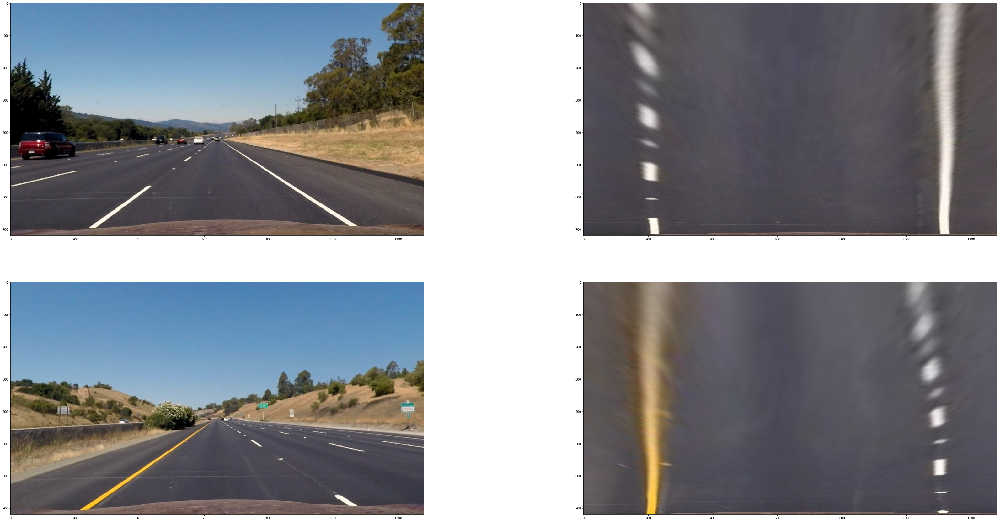

In [14]:
# Show Preview for straight line warping
warped_straight_imgs = list(map(lambda x : cv2.warpPerspective(x, M, (x.shape[1],x.shape[0])), undistorted_straight_imgs))

show_preview([j for i in zip(undistorted_straight_imgs, warped_straight_imgs) for j in i])


In [15]:
# binary_imgs = glob.glob('output02_binary_imgs/*.jpg')  
# warped_imgs = []

# for idx, binary_img in enumerate(binary_imgs):
#     img = mpimg.imread(binary_img)
#     img_size = (img.shape[1],img.shape[0])
#     warped = cv2.warpPerspective(img, M, img_size)
#     cv2.imwrite('output03_warped_imgs/' + binary_img[12:], warped)
#     warped_imgs.append(warped)

# show_preview(warped_imgs, 4)    


## TRYING OUT METHOD 1

In [24]:
# PARAMS TAKEN FROM CLASS
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# -----------------------------------------------#
# Functions to find lane pixels in warped image:
# -----------------------------------------------#

def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]*(2/3)):,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    print(str(leftx_base) + ' and ' + str(rightx_base))
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 20

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        

    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    

    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

        
    leftx_cr = left_fitx[::-1]  # Reverse to match top-to-bottom in y
    rightx_cr = right_fitx[::-1]  # Reverse to match top-to-bottom in y
    leftx_cr = left_fitx  # Reverse to match top-to-bottom in y
    rightx_cr = right_fitx  # Reverse to match top-to-bottom in y



    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx_cr*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx_cr*xm_per_pix, 2)
        
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    
    return out_img, ploty, left_fit, left_fit_cr, right_fit, right_fit_cr, left_fitx, right_fitx


# --------------------------------#
# Functions to measure curvature:
# --------------------------------#

    
def measure_curvature_pixels(ploty, left_fit_cr, right_fit_cr):
    '''
    Calculates the curvature of polynomial functions in pixels.
    '''    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
        
    return left_curverad, right_curverad

def get_description_text(ploty, left_fit_cr, right_fit_cr, left_fitx, right_fitx):
    res = ''
    # Calculate the radius of curvature in pixels for both lane lines
    left_curverad, right_curverad = measure_curvature_pixels(ploty, left_fit_cr, right_fit_cr)
    rad_curv = 'Radius of Curvature ' + str(round((left_curverad+right_curverad)/2, 3)) + 'm'

    middle_of_image = img.shape[1]/2
    left_lane_from_middle = abs(middle_of_image - left_fitx[0])
    right_lane_from_middle = abs(middle_of_image - right_fitx[0])
    diff_car_to_lane = (left_lane_from_middle - right_lane_from_middle)/2
    center_lane = ''
    if diff_car_to_lane > 0:
        center_lane = 'Offset from center lane ' + str(round(diff_car_to_lane*xm_per_pix, 2)) + 'm to the right'
    elif diff_car_to_lane < 0:
        center_lane = 'Offset from center lane ' + str(round(-diff_car_to_lane*xm_per_pix, 2)) + 'm to the left'
    else:
        center_lane = 'Driving perfectly in the middle of the lane'
    return rad_curv, center_lane


# -------------------------------------------------------#
# Functions to warp back information and annotate image:
# -------------------------------------------------------#

def warp_back(warped, image, undist, txt, Minv, ploty, left_fitx, right_fitx):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    cv2.putText(result,txt[0], (100,50), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 2)
    cv2.putText(result,txt[1], (100,100), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 2)

    return result 



# Plug the whole pipeline together

314 and 1223
177 and 1170
258 and 1191
258 and 1222
315 and 1165
277 and 1157
212 and 1122
210 and 1108
349 and 1058
271 and 1257


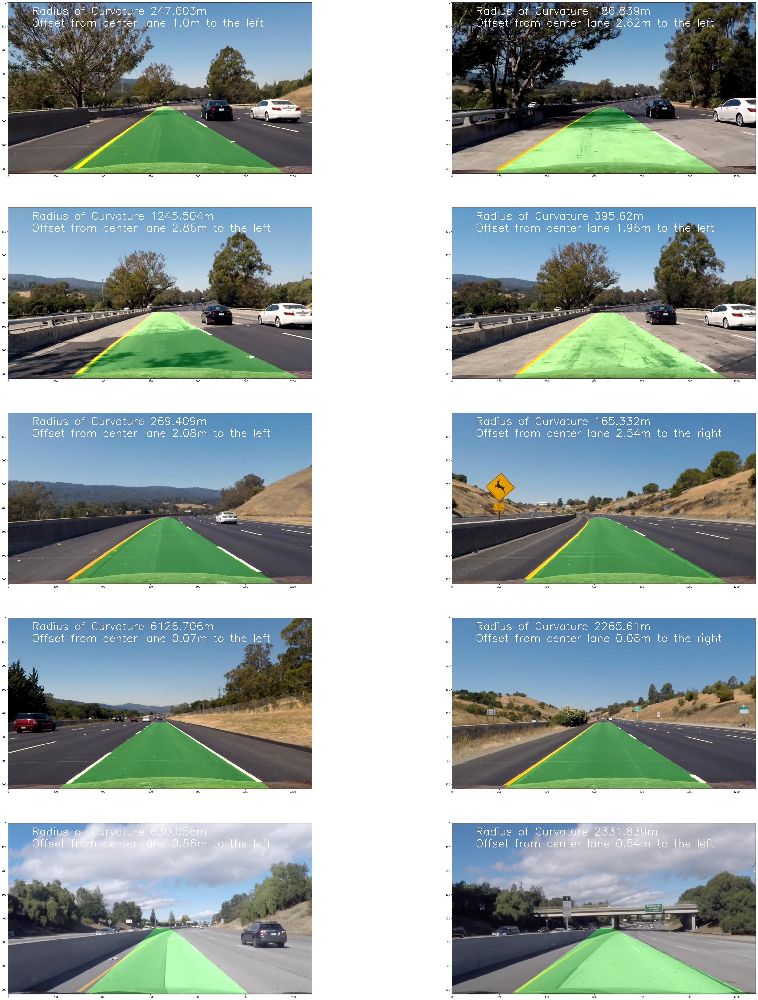

In [25]:
# General Parameters
img_size = (1280, 720)
# Parameters to undistort from calibrated camera
mtx = mtx
dist = dist
# Parameters for perspective transformations
M = M
Minv = Minv

def run_pipeline(img, fname=""):
    save_img = fname != ""

    img_undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    if save_img:
        cv2.imwrite('output01_undistorted_imgs/' + fname, cv2.cvtColor(img_undistorted, cv2.COLOR_RGB2BGR))
    
    img_binary = make_binary(img_undistorted)
    img_cropped = crop_to_roi(img_binary)
    if save_img:
        cv2.imwrite('output02_binary_imgs/' + fname, cv2.cvtColor(img_cropped, cv2.COLOR_RGB2BGR))
        
#     plt.figure(figsize=(100,100))
#     plt.imshow(img_cropped)
    
    img_warped = cv2.warpPerspective(img_cropped, M, img_size)
    img_warped_gray = cv2.cvtColor(img_warped, cv2.COLOR_RGB2GRAY)
    if save_img:
        cv2.imwrite('output03_warped_imgs/' + fname, cv2.cvtColor(img_warped, cv2.COLOR_RGB2BGR))

        
        
    img_fitted_pack = fit_polynomial(img_warped_gray)
    img_fitted, ploty, left_fit, left_fit_cr, right_fit, right_fit_cr, left_fitx, right_fitx = img_fitted_pack
    # paint fitted curve onto image         
    for point in zip(left_fitx.astype(int), ploty.astype(int)):
        cv2.circle(img_fitted,point,2,(255,255,0),2)
    for point in zip(right_fitx.astype(int), ploty.astype(int)):
        cv2.circle(img_fitted,point,2,(255,255,0),2)
    if save_img:
        cv2.imwrite('output04_fitted_imgs/' + fname, cv2.cvtColor(img_fitted, cv2.COLOR_RGB2BGR))
    
#     plt.figure(figsize=(100,100))
#     plt.imshow(img_fitted)
        
    txt = get_description_text(ploty, left_fit_cr, right_fit_cr, left_fitx, right_fitx)
    img_annotated = warp_back(img_warped_gray, img_undistorted, img_undistorted, txt, Minv, ploty, left_fitx, right_fitx)
    if save_img:
        cv2.imwrite('output_images/' + fname, cv2.cvtColor(img_annotated, cv2.COLOR_RGB2BGR))
    
    return img_annotated

# img = mpimg.imread('own_tests/1.jpg')
# test = run_pipeline(img)
# plt.figure(figsize=(100,100))
# plt.imshow(test)





results = []
for fname in glob.glob('test_images/*.jpg'):
    img = mpimg.imread(fname)
    res = run_pipeline(img, fname[12:])
    results.append(res)
show_preview(results)



    

In [63]:
video = 'project_video.mp4'
# video = 'challenge_video.mp4'
# video = 'harder_challenge_video.mp4'
output = 'test_videos_output/' + video
clip = VideoFileClip(video)
processed_clip = clip.fl_image(run_pipeline) #NOTE: this function expects color images!!
%time processed_clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video test_videos_output/project_video.mp4
[MoviePy] Writing video test_videos_output/project_video.mp4


100%|█████████▉| 1260/1261 [03:54<00:00,  6.67it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/project_video.mp4 

CPU times: user 3min 59s, sys: 30.1 s, total: 4min 29s
Wall time: 3min 55s


In [44]:
test_videos = list(filter(lambda x: x.find("project_video.mp4") >= 0, glob.glob("test_videos_output/*.mp4")))
html_string = ""

for video in test_videos:
    html_string = html_string + """
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video)

HTML(html_string)

# Other Pipelines for Writeup or Visual Testing

In [52]:

def run_pipeline_for_binary(img):
    img_undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    
    img_binary = make_binary(img_undistorted)
    img_cropped = crop_to_roi(img_binary)

    return np.vstack((img,img_cropped))

def run_pipeline_for_fitted(img):
    img_undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    
    img_binary = make_binary(img_undistorted)
    img_cropped = crop_to_roi(img_binary)

    img_warped = cv2.warpPerspective(img_cropped, M, img_size)
    img_warped_gray = cv2.cvtColor(img_warped, cv2.COLOR_RGB2GRAY)

    img_fitted_pack = fit_polynomial(img_warped_gray)
    img_fitted, ploty, left_fit, left_fit_cr, right_fit, right_fit_cr, left_fitx, right_fitx = img_fitted_pack
    # paint fitted curve onto image         
    for point in zip(left_fitx.astype(int), ploty.astype(int)):
        cv2.circle(img_fitted,point,2,(255,255,0),2)
    for point in zip(right_fitx.astype(int), ploty.astype(int)):
        cv2.circle(img_fitted,point,2,(255,255,0),2)
        
    return np.vstack((img,img_fitted))

def run_pipeline_for_warped(img):
    img_undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    
    img_binary = make_binary(img_undistorted)
    img_cropped = crop_to_roi(img_binary)

    img_warped = cv2.warpPerspective(img_cropped, M, img_size)
        
    return np.vstack((img,img_warped))

In [65]:
videos = glob.glob("challe*.mp4")
# for video in videos:
#     output = 'test_videos_output/binary_' + video
#     clip = VideoFileClip(video)
#     processed_clip = clip.fl_image(run_pipeline_for_binary) #NOTE: this function expects color images!!
#     %time processed_clip.write_videofile(output, audio=False)
# for video in videos:
#     output = 'test_videos_output/fitted_' + video
#     clip = VideoFileClip(video)
#     processed_clip = clip.fl_image(run_pipeline_for_fitted) #NOTE: this function expects color images!!
#     %time processed_clip.write_videofile(output, audio=False)
for video in videos:
    output = 'test_videos_output/warped_' + video
    clip = VideoFileClip(video)
    processed_clip = clip.fl_image(run_pipeline_for_warped) #NOTE: this function expects color images!!
    %time processed_clip.write_videofile(output, audio=False)    

[MoviePy] >>>> Building video test_videos_output/warped_challenge_video.mp4
[MoviePy] Writing video test_videos_output/warped_challenge_video.mp4


100%|██████████| 485/485 [00:53<00:00, 10.51it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/warped_challenge_video.mp4 

CPU times: user 54.7 s, sys: 3.57 s, total: 58.3 s
Wall time: 54.4 s


# TODO

- [x] make yellow lane white
- [x] stop window fitting if no pixels hot
- [x] stop window fitting if too far away from old one
- [ ] start fitting at known distance
- [ ] if confidence low, go parallel to other
- [ ] check for white lanes not black lanes
- [ ] doublecheck center offset

# Appendix

Experimental Code

In [ ]:
# Method 2 to find Lane Pixels

# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids


warped_imgs = list(map(lambda x: cv2.cvtColor(mpimg.imread(x), cv2.COLOR_RGB2GRAY), glob.glob('output03_warped_imgs/*jpg')))
images = []


# Read in a thresholded image
warped = warped_imgs[0]
for warped in warped_imgs:

    window_centroids = find_window_centroids(warped, window_width, window_height, margin)

    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows    
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

    images.append(output)

#     # Display the final results
#     plt.imshow(output)
#     plt.title('window fitting results')
#     plt.show()
show_preview(images, 4, 60,20)